<h2>Loading a pre-trained YOLOv5m instance for Solar Panel Object Detection</h2>


We've collected our own data and manually annotated 200 images for object detection (solar panels) using YOLO. The link to the dataset uploaded on kaggle is as follows: https://www.kaggle.com/datasets/mabubakarmughal/satellite-imagery-lahore-dha-phase-6

We've added a detailed explanation of the dataset on the provided link, please go through it. The purpose of this notebook was to fine-tune the pre-trained YOLOv5m model on the existing data (which we've referenced in our previous deliverables) and then fine-tune it further for our own data. At the end of the notebook, we've visualised the results of the model on our data. The goal was to enable the model to perform object detection on relatively lower-resolution data for Pakistan which is limited in quantity. 

In [1]:
!git clone https://github.com/ultralytics/yolov5  
%cd yolov5
!pip install -r requirements.txt

Cloning into 'yolov5'...
remote: Enumerating objects: 17410, done.
remote: Counting objects: 100% (84/84), done.
remote: Compressing objects: 100% (62/62), done.
remote: Total 17410 (delta 63), reused 22 (delta 22), pack-reused 17326 (from 3)
Receiving objects: 100% (17410/17410), 16.30 MiB | 25.37 MiB/s, done.
Resolving deltas: 100% (11934/11934), done.
/kaggle/working/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 29.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 12.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.2 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 71.3 MB/s eta

<h3>Setting up the images and labels in correct directory structure</h3>

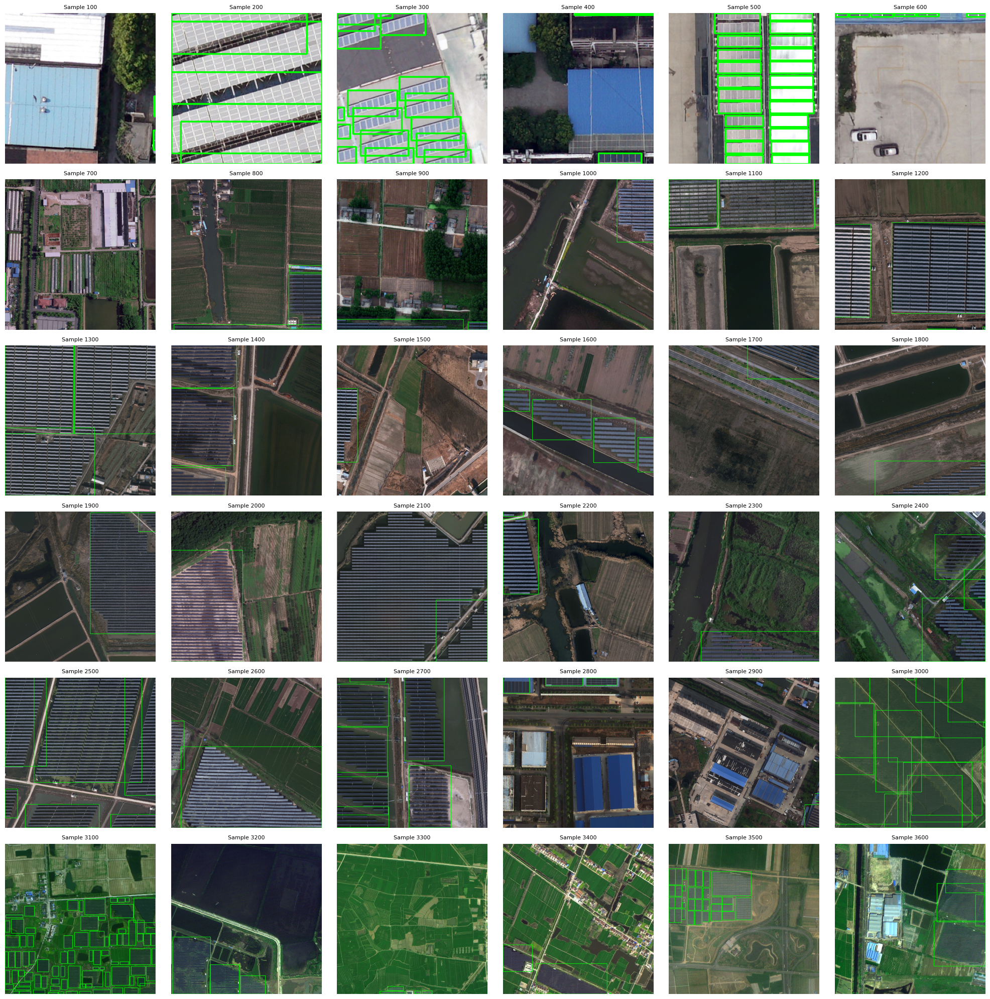

In [2]:
import matplotlib.pyplot as plt
import os
import cv2
import math

# Kaggle input directory
base_dir = "/kaggle/input/solardata-preprocessed"
images_dir = os.path.join(base_dir, "images")
labels_dir = os.path.join(base_dir, "labels")

def visualize_grid(start_idx=100, end_idx=3700, step=100, cols=6, rows=6):
    total_samples = math.ceil((end_idx - start_idx) / step)
    plt.figure(figsize=(20, 20))

    for i in range(total_samples):
        idx = start_idx + i * step
        if idx > end_idx:
            break

        img_filename = f"img_{idx:05d}.bmp"
        label_filename = f"img_{idx:05d}.txt"
        img_path = os.path.join(images_dir, img_filename)
        label_path = os.path.join(labels_dir, label_filename)

        if not os.path.exists(img_path):
            print(f"⚠️ Missing image: {img_filename}")
            continue

        img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
        h, w = img.shape[:2]

        # Draw bounding boxes if label file exists
        if os.path.exists(label_path):
            with open(label_path) as f:
                for line in f:
                    cls, xc, yc, bw, bh = map(float, line.strip().split())
                    x1 = int((xc - bw/2) * w)
                    y1 = int((yc - bh/2) * h)
                    x2 = int((xc + bw/2) * w)
                    y2 = int((yc + bh/2) * h)
                    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        plt.subplot(rows, cols, i+1)
        plt.imshow(img)
        plt.title(f"Sample {idx}", fontsize=8)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Visualize in chunks of 36 samples, spaced by 100
for start in range(100, 3700, 36 * 100):
    end = min(start + 36 * 100 - 1, 3700)
    visualize_grid(start, end, step=100, cols=6, rows=6)


<h2>Visualising Annotated Images from our local dataset.</h2>

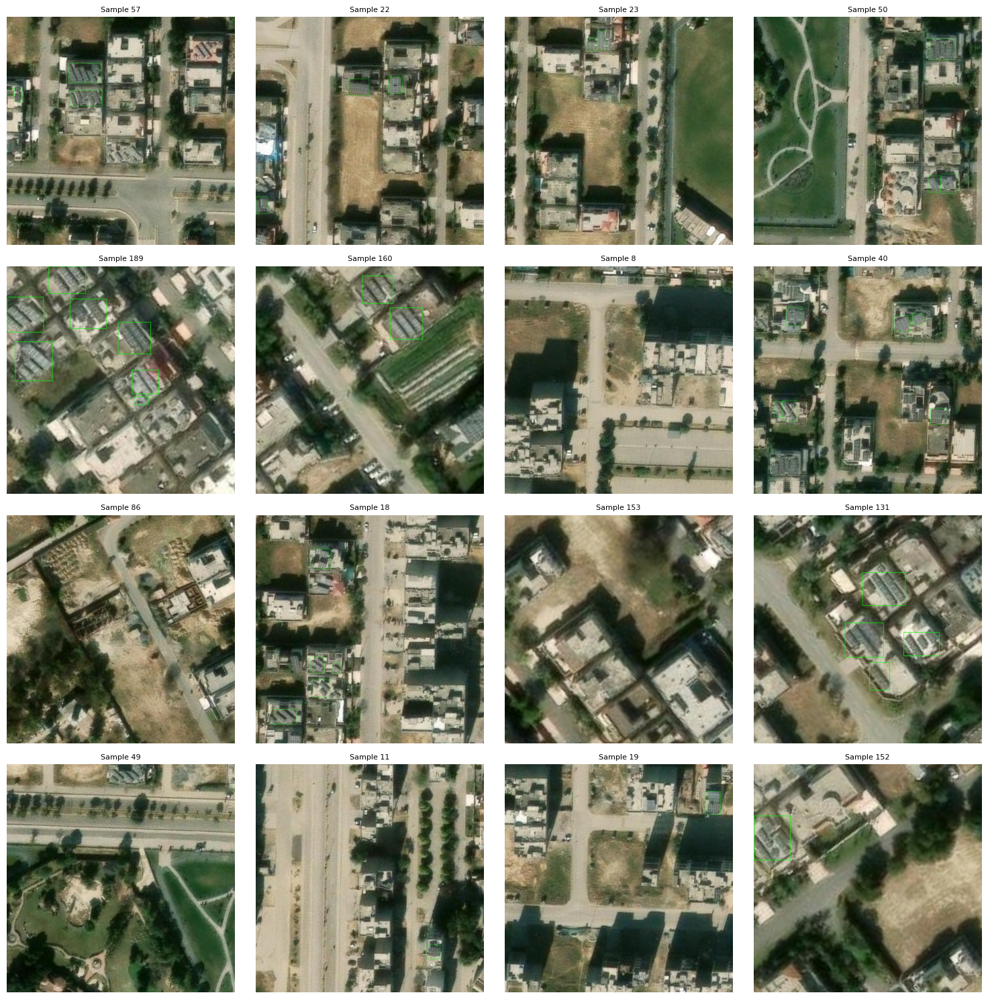

In [3]:
import matplotlib.pyplot as plt
import os
import cv2
import random

# Kaggle input directory for the second dataset
base_dir = "/kaggle/input/satellite-imagery-lahore-dha-phase-6"
images_dir = os.path.join(base_dir, "images")
labels_dir = os.path.join(base_dir, "labels")

def visualize_random_grid(num_images=16, cols=4, rows=4):
    # Generate a list of random indices based on the number of images in the dataset
    total_images = len(os.listdir(images_dir))
    random_indices = random.sample(range(total_images), num_images)

    plt.figure(figsize=(15, 15))

    for i, idx in enumerate(random_indices):
        img_filename = f"exported_grid_{idx}.png"
        label_filename = f"exported_grid_{idx}_label.txt"
        img_path = os.path.join(images_dir, img_filename)
        label_path = os.path.join(labels_dir, label_filename)

        if not os.path.exists(img_path):
            print(f"⚠️ Missing image: {img_filename}")
            continue

        img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
        h, w = img.shape[:2]

        # Draw bounding boxes if label file exists
        if os.path.exists(label_path):
            with open(label_path) as f:
                for line in f:
                    cls, xc, yc, bw, bh = map(float, line.strip().split())
                    x1 = int((xc - bw / 2) * w)
                    y1 = int((yc - bh / 2) * h)
                    x2 = int((xc + bw / 2) * w)
                    y2 = int((yc + bh / 2) * h)
                    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.title(f"Sample {idx}", fontsize=8)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Visualize 16 random images in a 4x4 grid
visualize_random_grid(num_images=16, cols=4, rows=4)


<h3>Setting up training files for YOLOv5M</h3>

In [4]:
import os
import shutil
from sklearn.model_selection import train_test_split

# Setup directories
source_images_dir = "/kaggle/input/solardata-preprocessed/images"  # Source directory for images
source_labels_dir = "/kaggle/input/solardata-preprocessed/labels"  # Source directory for labels
yolo_dataset_dir = "/kaggle/working/solar_yolo"

# Create target directories
os.makedirs(f"{yolo_dataset_dir}/images/train", exist_ok=True)
os.makedirs(f"{yolo_dataset_dir}/images/test", exist_ok=True)
os.makedirs(f"{yolo_dataset_dir}/labels/train", exist_ok=True)
os.makedirs(f"{yolo_dataset_dir}/labels/test", exist_ok=True)

# Get all image filenames (without path) and their corresponding label filenames
image_files = [f for f in os.listdir(source_images_dir) if f.endswith('.bmp')]
label_files = [f.replace('.bmp', '.txt') for f in image_files]

# Zip the image files with their corresponding label files
image_label_pairs = list(zip(image_files, label_files))

# Shuffle the pairs
train_pairs, test_pairs = train_test_split(image_label_pairs, test_size=0.2, random_state=42)

# Copy the files to the appropriate directories
for img_file, lbl_file in train_pairs:
    # Source paths
    src_img = os.path.join(source_images_dir, img_file)
    src_label = os.path.join(source_labels_dir, lbl_file)
    
    # Copy to train directories
    shutil.copy(src_img, os.path.join(yolo_dataset_dir, "images/train", img_file))
    shutil.copy(src_label, os.path.join(yolo_dataset_dir, "labels/train", lbl_file))

for img_file, lbl_file in test_pairs:
    # Source paths
    src_img = os.path.join(source_images_dir, img_file)
    src_label = os.path.join(source_labels_dir, lbl_file)
    
    # Copy to test directories
    shutil.copy(src_img, os.path.join(yolo_dataset_dir, "images/test", img_file))
    shutil.copy(src_label, os.path.join(yolo_dataset_dir, "labels/test", lbl_file))

# Create YAML config
data_yaml = f"""
path: {yolo_dataset_dir}
train: images/train
val: images/test  # Using test set as validation
nc: 1
names: ['solar_panel']
"""

with open(f"{yolo_dataset_dir}/data.yaml", "w") as f:
    f.write(data_yaml)

print("Dataset preparation complete!")
print(f"Train samples: {len(train_pairs)}")
print(f"Test samples: {len(test_pairs)}")


Dataset preparation complete!
Train samples: 2972
Test samples: 744


<h3>Initialising training/fine-tuning on existing data obtained from the dataset we referenced in our initial deliverables - Extension of the Baseline Implementation</h3>

In [5]:
!python train.py --img 640 --batch 32 --epochs 20 --data /kaggle/working/solar_yolo/data.yaml --weights yolov5m.pt --name solar_detect --cache

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-04-22 19:07:40.239594: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1745348860.488883     105 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1745348860.557513     105 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS wh

<h3>Running test inferences on the existing dataset</h3>

In [7]:
!python /kaggle/working/yolov5/detect.py --weights /kaggle/working/yolov5/runs/train/solar_detect/weights/best.pt --img 640 --source /kaggle/working/solar_yolo/images/test --save-txt

detect: weights=['/kaggle/working/yolov5/runs/train/solar_detect/weights/best.pt'], source=/kaggle/working/solar_yolo/images/test, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-416-gfe1d4d99 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)

Fusing layers... 
Model summary: 212 layers, 20852934 parameters, 0 gradients, 47.9 GFLOPs
image 1/744 /kaggle/working/solar_yolo/images/test/img_00001.bmp: 640x640 1 solar_panel, 27.0ms
image 2/744 /kaggle/working/solar_yolo/images/test/img_00004.bmp: 640x640 (no detections), 27.1ms
image 3/744 /kaggle/working/solar_yolo/images/test/img_

<h3>Preparing our scraped data for further fine-tuning of the model instance</h3>

Kaggle dataset link: https://www.kaggle.com/datasets/mabubakarmughal/satellite-imagery-lahore-dha-phase-6

We've explained the dataset in more depth at the given URL. 

In [ ]:
import os
import shutil
from sklearn.model_selection import train_test_split
from PIL import Image

source_images_dir = "/kaggle/input/satellite-imagery-lahore-dha-phase-6/images" 
source_labels_dir = "/kaggle/input/satellite-imagery-lahore-dha-phase-6/labels"  
yolo_dataset_dir = "/kaggle/working/satellite_yolo"

os.makedirs(f"{yolo_dataset_dir}/images/train", exist_ok=True)
os.makedirs(f"{yolo_dataset_dir}/images/test", exist_ok=True)
os.makedirs(f"{yolo_dataset_dir}/labels/train", exist_ok=True)
os.makedirs(f"{yolo_dataset_dir}/labels/test", exist_ok=True)

image_files = [f for f in os.listdir(source_images_dir) if f.endswith('.png')]
label_files = [f.replace('.png', '_label.txt') for f in image_files]

image_label_pairs = list(zip(image_files, label_files))

train_pairs, test_pairs = train_test_split(image_label_pairs, test_size=0.2, random_state=42)


for img_file, lbl_file in train_pairs:
    src_img = os.path.join(source_images_dir, img_file)
    src_label = os.path.join(source_labels_dir, lbl_file)


    new_lbl_file = lbl_file.replace('_label', '')

    assert os.path.exists(src_label), f"Label file {src_label} not found"


    img = Image.open(src_img)
    bmp_img_file = img_file.replace('.png', '.bmp')
    bmp_img_path = os.path.join(yolo_dataset_dir, "images/train", bmp_img_file)
    img.save(bmp_img_path, 'BMP')

    shutil.copy(src_label, os.path.join(yolo_dataset_dir, "labels/train", new_lbl_file))

for img_file, lbl_file in test_pairs:
    src_img = os.path.join(source_images_dir, img_file)
    src_label = os.path.join(source_labels_dir, lbl_file)


    new_lbl_file = lbl_file.replace('_label', '')

    img = Image.open(src_img)
    bmp_img_file = img_file.replace('.png', '.bmp')
    bmp_img_path = os.path.join(yolo_dataset_dir, "images/test", bmp_img_file)
    img.save(bmp_img_path, 'BMP')

    shutil.copy(src_label, os.path.join(yolo_dataset_dir, "labels/test", new_lbl_file))

data_yaml = f"""
path: {yolo_dataset_dir}
train: images/train
val: images/test  # Using test set as validation
nc: 1
names: ['solar_panel']
"""

with open(f"{yolo_dataset_dir}/data.yaml", "w") as f:
    f.write(data_yaml)

print("Dataset preparation complete!")
print(f"Train samples: {len(train_pairs)}")
print(f"Test samples: {len(test_pairs)}")

Dataset preparation complete!
Train samples: 160
Test samples: 40


<h3>Fine-tuning on our local scraped Lahore dataset</h3>

In [2]:
!python /kaggle/working/yolov5/train.py --img 640 --batch 16 --epochs 10 --data /kaggle/working/satellite_yolo/data.yaml --weights /kaggle/working/yolov5/runs/train/solar_detect/weights/best.pt --name solar_detect_further --cache

wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-04-22 19:44:39.102231: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1745351079.125727    4297 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1745351079.134367    4297 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: (30 second timeout) 
wandb: W&B disabled due to login timeout.
wandb: WARNING If you're specifying your api key in code, ensure this code is 

<h3>Running Test Inferences on our scraped dataset</h3>

In [3]:
!python /kaggle/working/yolov5/detect.py --weights /kaggle/working/yolov5/runs/train/solar_detect_further/weights/best.pt --img 640 --source /kaggle/working/satellite_yolo/images/test --save-txt

detect: weights=['/kaggle/working/yolov5/runs/train/solar_detect_further/weights/best.pt'], source=/kaggle/working/satellite_yolo/images/test, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-416-gfe1d4d99 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)

Fusing layers... 
Model summary: 212 layers, 20852934 parameters, 0 gradients, 47.9 GFLOPs
image 1/40 /kaggle/working/satellite_yolo/images/test/exported_grid_100.bmp: 640x640 4 solar_panels, 27.1ms
image 2/40 /kaggle/working/satellite_yolo/images/test/exported_grid_101.bmp: 640x640 9 solar_panels, 27.1ms
image 3/40 /kaggle/wo

<h3>Visualising Test Predictions for the original dataset</h3>

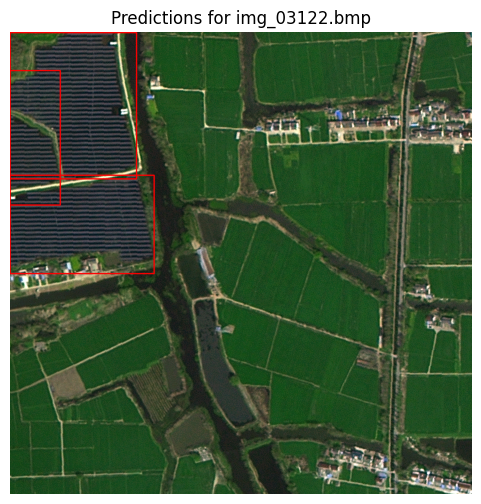

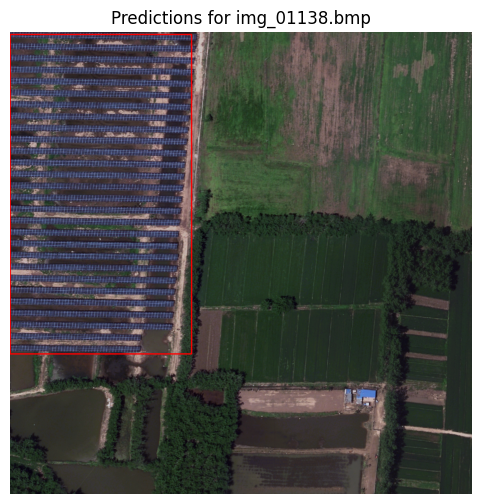

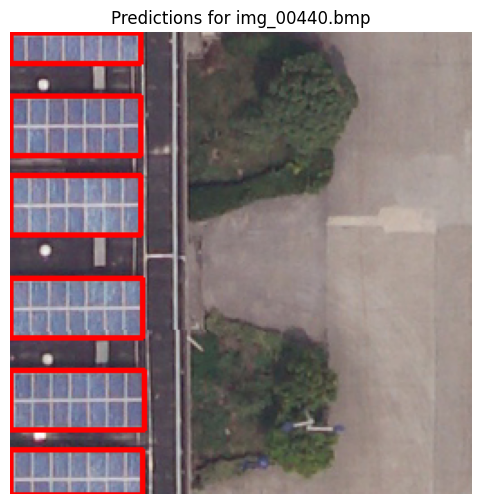

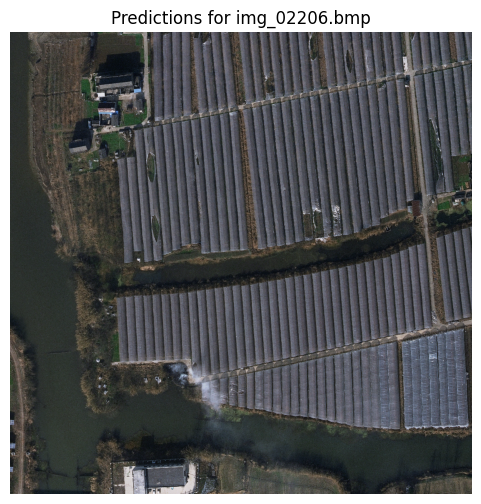

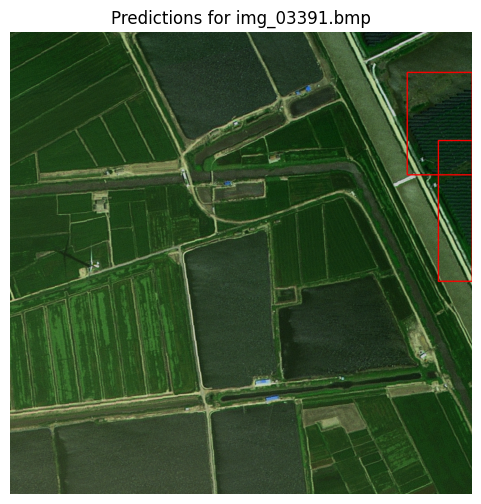

...

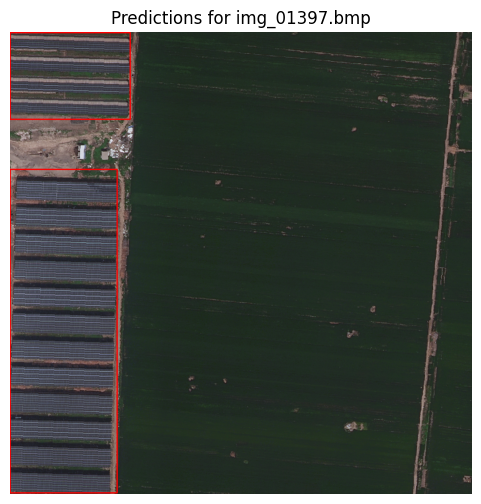

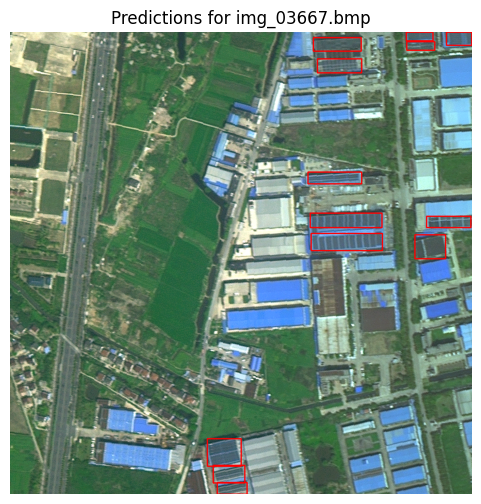

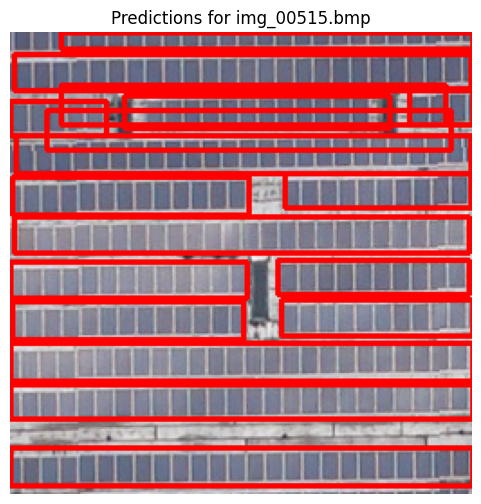

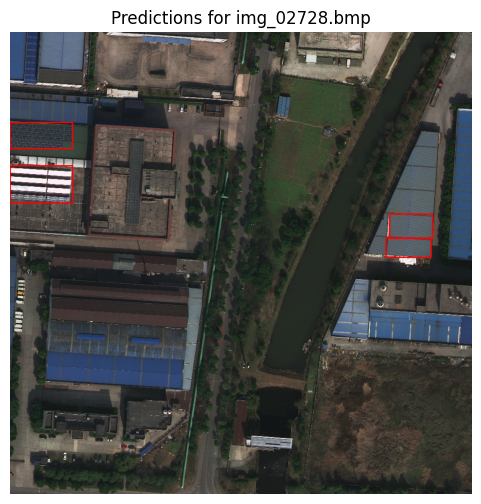

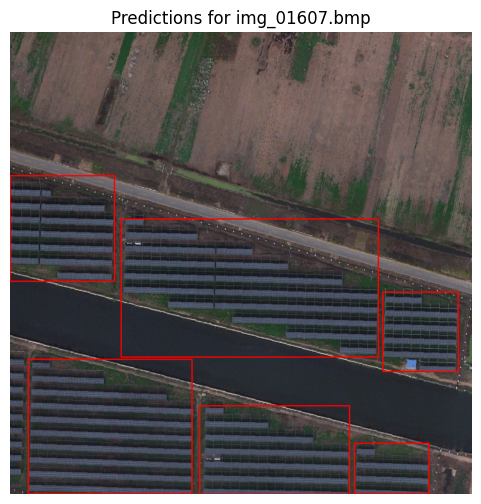

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

image_dir = '/kaggle/working/solar_yolo/images/test'
label_dir = '/kaggle/working/yolov5/runs/detect/exp/labels'

image_files = [f for f in os.listdir(image_dir) if f.endswith('.bmp')][:20]

for image_file in image_files:
    image_path = os.path.join(image_dir, image_file)
    label_file = os.path.splitext(image_file)[0] + '.txt'  
    label_path = os.path.join(label_dir, label_file)
    
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                class_id = int(parts[0]) 
                x_center, y_center, width, height = map(float, parts[1:])
                
                h, w, _ = image.shape
                x_center *= w
                y_center *= h
                width *= w
                height *= h
                
                x1 = int(x_center - width / 2)
                y1 = int(y_center - height / 2)
                x2 = int(x_center + width / 2)
                y2 = int(y_center + height / 2)
                
                cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)

    plt.figure(figsize=(6, 6))
    plt.imshow(image)
    plt.title(f"Predictions for {image_file}")
    plt.axis('off')
    plt.show()


<h3>Below we've visualised the 40 test images that were sent through the fine-tuned yolov5m model. Almost all test images that contained the target class (solar panels) have at least one instance of the object being detected. Even the really solar panel were detected which is a very good sign. Considering that we only fine-tuned the 22 million parameter model using just 160 relatively low-resolution images, these results are indeed welcome. Although the predictions are far from perfect, as can be seen by a lot of the missed objects as well as some instances of bad predictions which are mainly due to the colour/shape blending, the ability of the model to capture smaller objects is a positive sign.</h3>

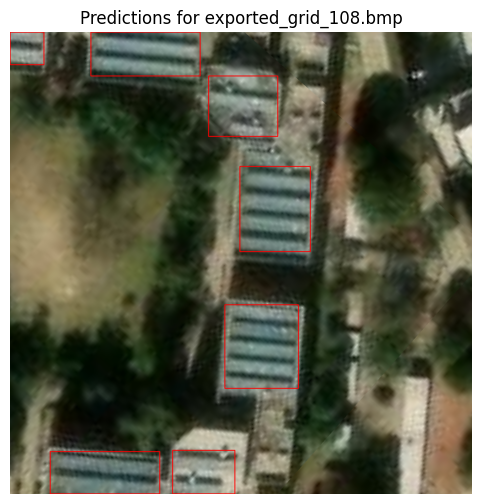

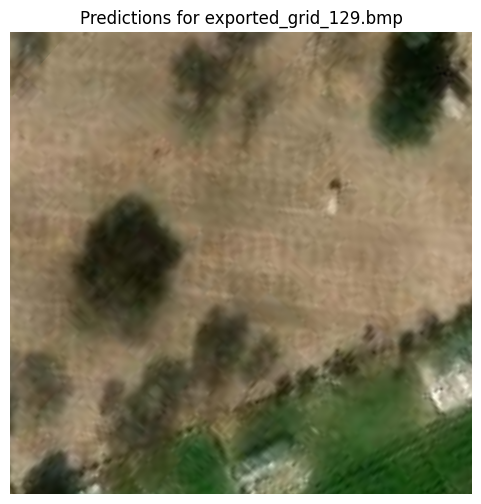

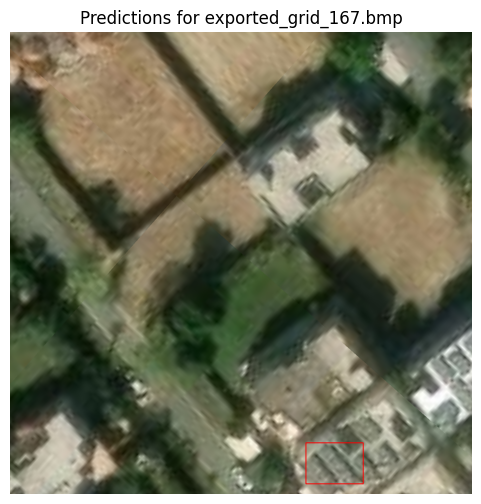

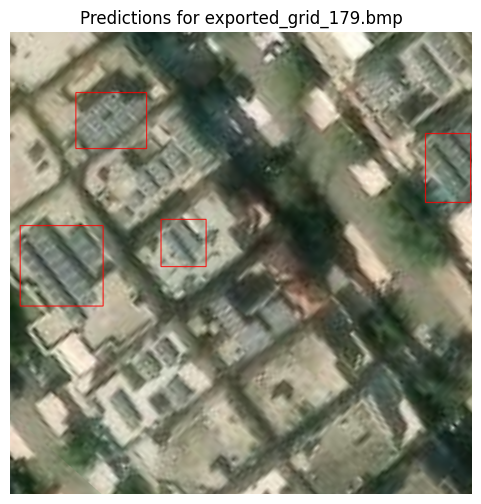

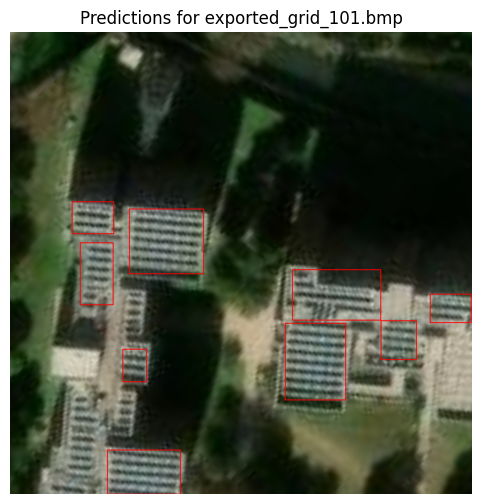

...

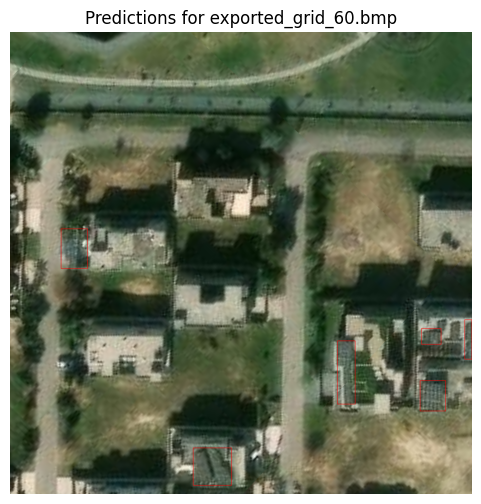

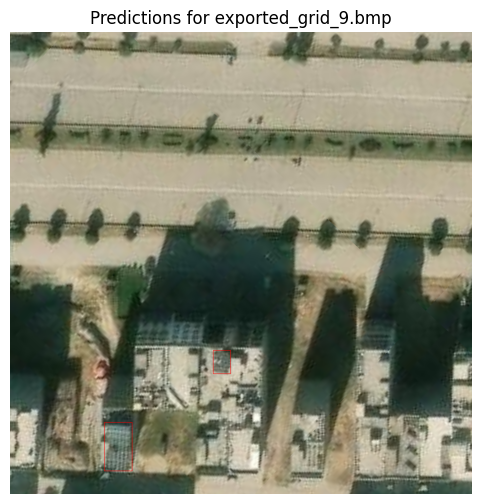

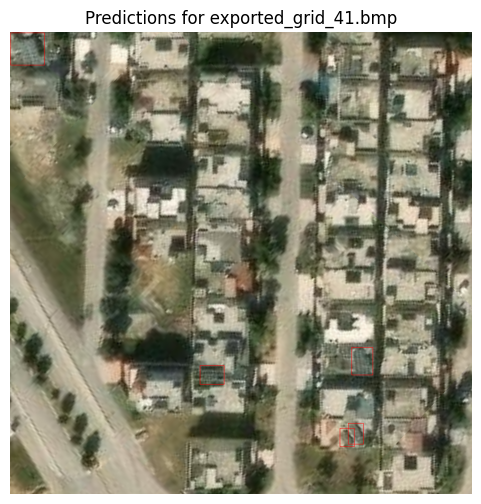

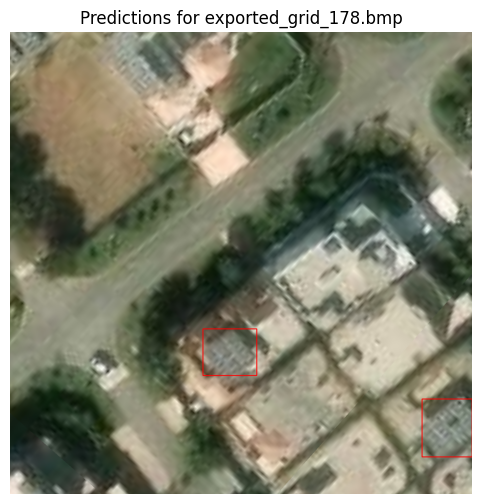

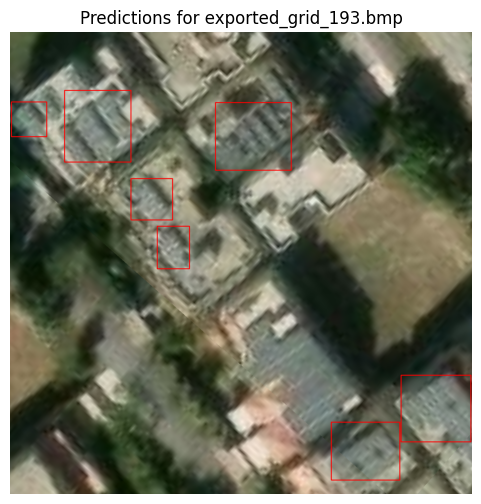

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

image_dir = '/kaggle/working/satellite_yolo/images/test'
label_dir = '/kaggle/working/yolov5/runs/detect/exp/labels'


image_files = [f for f in os.listdir(image_dir) if f.endswith('.bmp')][:]

for image_file in image_files:
    image_path = os.path.join(image_dir, image_file)
    label_file = os.path.splitext(image_file)[0] + '.txt'  
    label_path = os.path.join(label_dir, label_file)
    
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                class_id = int(parts[0]) 
                x_center, y_center, width, height = map(float, parts[1:])
                
                h, w, _ = image.shape
                x_center *= w
                y_center *= h
                width *= w
                height *= h
                
                x1 = int(x_center - width / 2)
                y1 = int(y_center - height / 2)
                x2 = int(x_center + width / 2)
                y2 = int(y_center + height / 2)
                
                cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)

    plt.figure(figsize=(6, 6))
    plt.imshow(image)
    plt.title(f"Predictions for {image_file}")
    plt.axis('off')
    plt.show()
